In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


#Query Encoder

In [4]:
! pip install ftfy regex tqdm
! pip install git+https://github.com/openai/CLIP.git

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.1/53.1 kB 1.8 MB/s eta 0:00:00
  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-2_evf4s2
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-2_evf4s2
  Resolved https://github.com/openai/CLIP.git to commit a1d071733d7111c9c014f024669f959182114e33
  Preparing metadata (setup.py) ... done
  Created wheel for clip: filename=clip-1.0-py3-none-any.whl size=1369497 sha256=9f2d489aa612bf55f7f0aa315f064927268b815e513d74e4f4bdcb6214463c54
  Stored in directory: /tmp/pip-ephem-wheel-cache-9g6zfom7/wheels/da/2b/4c/d6691fa9597aac8bb85d2ac13b112deb897d5b50f5ad9a37e4
Successfully built clip


In [2]:
import numpy as np
import torch
from pkg_resources import packaging

print("Torch version:", torch.__version__)

Torch version: 2.0.1+cu118


In [5]:
import clip

clip.available_models()

['RN50',
 'RN101',
 'RN50x4',
 'RN50x16',
 'RN50x64',
 'ViT-B/32',
 'ViT-B/16',
 'ViT-L/14',
 'ViT-L/14@336px']

##Build class query encoder

In [6]:
class TextEmbedding():
  def __init__(self,model_name):
    self.device = "cuda" if torch.cuda.is_available() else "cpu"
    self.model, _ = clip.load(model_name, device=self.device)
    self.model.eval()

  def __call__(self, texts: str) -> np.ndarray:
    text_inputs = clip.tokenize(texts).to(self.device)
    with torch.no_grad():
        text_feature = self.model.encode_text(text_inputs)
        #print(text_feature.shape)
        text_feature /= text_feature.norm(dim=-1, keepdim=True)

    return text_feature.detach().cpu().numpy()

In [7]:
text = ["a presenter wearing a white shirt, glasses,red tie, holding a red box, he is hosting"]
#L01_V002/0248.jpg
text_embedd = TextEmbedding("ViT-B/32")
text_feat_arr = text_embedd(text)[0]
print(text_feat_arr.shape, type(text_feat_arr))

100%|████████████████████████████████████████| 338M/338M [00:01<00:00, 309MiB/s]


(512,) <class 'numpy.ndarray'>


#Encoder keyframe

##Img Encoder

In [8]:
from PIL import Image
import os
import glob
from typing import List, Tuple
import numpy as np
from tqdm import tqdm


In [9]:
class ImageEmbedding():
    def __init__(self,model_name):
        self.device = "cuda" if torch.cuda.is_available() else "cpu"
        self.model, self.preprocess = clip.load(model_name, device=self.device)
        self.model.eval()

    def __call__(self, image_path: str) -> np.ndarray:
        image = Image.open(image_path).convert("RGB")
        image_input = self.preprocess(image).unsqueeze(0).to(self.device)

        with torch.no_grad():
            image_feature = self.model.encode_image(image_input)[0]
            image_feature/= image_feature.norm(dim=-1, keepdim=True)
        return image_feature.detach().cpu().numpy()



In [10]:
# Example usage
image_embedder = ImageEmbedding('ViT-B/32')




#Lưu trữ thông tin keyframes và feature của nó

In [11]:
import os
import glob
from typing import List, Tuple
import numpy as np
from tqdm import tqdm


In [12]:
#PATH_TO_CLIPFEATURES='/content/drive/MyDrive/ColabNotebooks_2/AI_CHALLENGE_2023/ELO@AIC/Dataset/clip-features/'
#PATH_TO_CLIPFEATURES='/content/clip_fea/'
PATH_TO_CLIPFEATURES='/content/drive/MyDrive/ELO@AIC/Dataset/clip-features-vit-b32/'

#mỗi ketframe lưu 3 thông tin: tên file video, frame idx, feature vector-> vd: L01_V001,001,vector lưu sao cho truy xuất ra dc keyframe
def Database()-> List[Tuple[str, int, np.ndarray],]:
  data_base=[]
  for name_file_feature in tqdm(sorted(os.listdir(PATH_TO_CLIPFEATURES))):
    vid_name=name_file_feature.split('.')[0]
    features=np.load(os.path.join(PATH_TO_CLIPFEATURES,name_file_feature))
    for idx,feat in enumerate(features,1):
      instance=(vid_name,idx,feat)
      data_base.append(instance)
  return data_base






In [13]:
db=Database()
print(db[286][:2])
print(db[286][-1].shape)

100%|██████████| 737/737 [00:12<00:00, 58.26it/s] 

('L01_V002', 51)
(512,)


#Search

In [14]:
def search_engine(query_arr: np.array,
                  db: list,
                  topk:int=10,
                  measure_method: str="dot_product") -> List[dict,]:

  '''Duyệt tuyến tính và tính độ tương đồng giữa 2 vector'''
  measure = []
  for ins_id, instance in enumerate(db):
    video_name, idx, feat_arr = instance

    if measure_method=="dot_product":
      distance = query_arr @ feat_arr.T
    elif measure_method=="l1_norm":
      distance = -1 * np.mean([abs(q - t) for q, t in zip(query_arr, feat_arr)])# thêm dấu - để nó đảo chiều cùng mấy độ đo kia
    elif measure_method=="l2_norm":
      distance= -1*np.sqrt(((feat_arr-query_arr)**2).sum())
    elif measure_method=="cosin_similarity":
      tichvohuong_featarr_queryarr=(feat_arr*query_arr).sum()
      dodai_featarr=np.sqrt((feat_arr**2).sum())
      dodai_queryarr=np.sqrt((query_arr**2).sum())
      distance=tichvohuong_featarr_queryarr/(dodai_featarr*dodai_queryarr)#cosin
    elif measure_method=="cosin_euclid":
      tichvohuong_featarr_queryarr=(feat_arr*query_arr).sum()
      dodai_featarr=np.sqrt((feat_arr**2).sum())
      dodai_queryarr=np.sqrt((query_arr**2).sum())
      cosin=tichvohuong_featarr_queryarr/(dodai_featarr*dodai_queryarr)#cosin
      euclid=-1*np.sqrt(((feat_arr-query_arr)**2).sum())

      distance=10*cosin+1*euclid/10
    measure.append((ins_id, distance))

  '''Sắp xếp kết quả'''

  measure = sorted(measure, key=lambda x:x[-1], reverse=True)

  '''Trả về top K kết quả'''
  search_result = []
  for instance in measure[:topk]:
    ins_id, distance = instance
    video_name, idx, _ = db[ins_id]

    search_result.append({"video_name":video_name,
                          "keyframe_id": idx,
                          "score": distance})
  return search_result

#Visualize result

In [15]:
from PIL import Image

In [16]:
IMAGE_KEYFRAME_PATH='/content/drive/MyDrive/ELO@AIC/Dataset/KeyFrames/'+'keyframes_'
def extract_name_file_img(key_fr_id,video_name):
  if int(video_name[1:3])>=17:
    l=3-len(key_fr_id)
    return '0'*l+key_fr_id
  else:
    l=4-len(key_fr_id)
    return '0'*l+key_fr_id


def read_image(results: List[dict,]) -> List[Image.Image,]:
  images = []
  #k=0
  for res in results:
      image_path = os.path.join(IMAGE_KEYFRAME_PATH + res['video_name'][:-5], res["video_name"], extract_name_file_img(str(res['keyframe_id']),res['video_name'])+'.jpg')
      image = Image.open(image_path)
      print(image_path)
      images.append(image)
  return images

def visualize(imgs: List[Image.Image, ]) -> None:
    rows = len(imgs) // 5
    if not rows:
      rows += 1
    cols = len(imgs) // rows
    if rows*cols < len(imgs):
      rows += 1
    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    grid_w, grid_h = grid.size

    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols*w, i//cols*h))
    display(grid)




/content/drive/MyDrive/ELO@AIC/Dataset/KeyFrames/keyframes_L03/L03_V023/0025.jpg
/content/drive/MyDrive/ELO@AIC/Dataset/KeyFrames/keyframes_L02/L02_V004/0197.jpg
/content/drive/MyDrive/ELO@AIC/Dataset/KeyFrames/keyframes_L02/L02_V023/0107.jpg
/content/drive/MyDrive/ELO@AIC/Dataset/KeyFrames/keyframes_L02/L02_V024/0028.jpg
/content/drive/MyDrive/ELO@AIC/Dataset/KeyFrames/keyframes_L03/L03_V021/0004.jpg
/content/drive/MyDrive/ELO@AIC/Dataset/KeyFrames/keyframes_L01/L01_V011/0065.jpg
/content/drive/MyDrive/ELO@AIC/Dataset/KeyFrames/keyframes_L04/L04_V024/0143.jpg
/content/drive/MyDrive/ELO@AIC/Dataset/KeyFrames/keyframes_L02/L02_V019/0097.jpg
/content/drive/MyDrive/ELO@AIC/Dataset/KeyFrames/keyframes_L02/L02_V023/0119.jpg
/content/drive/MyDrive/ELO@AIC/Dataset/KeyFrames/keyframes_L19/L19_V019/088.jpg
/content/drive/MyDrive/ELO@AIC/Dataset/KeyFrames/keyframes_L02/L02_V007/0199.jpg
/content/drive/MyDrive/ELO@AIC/Dataset/KeyFrames/keyframes_L02/L02_V009/0154.jpg
/content/drive/MyDrive/ELO@AI

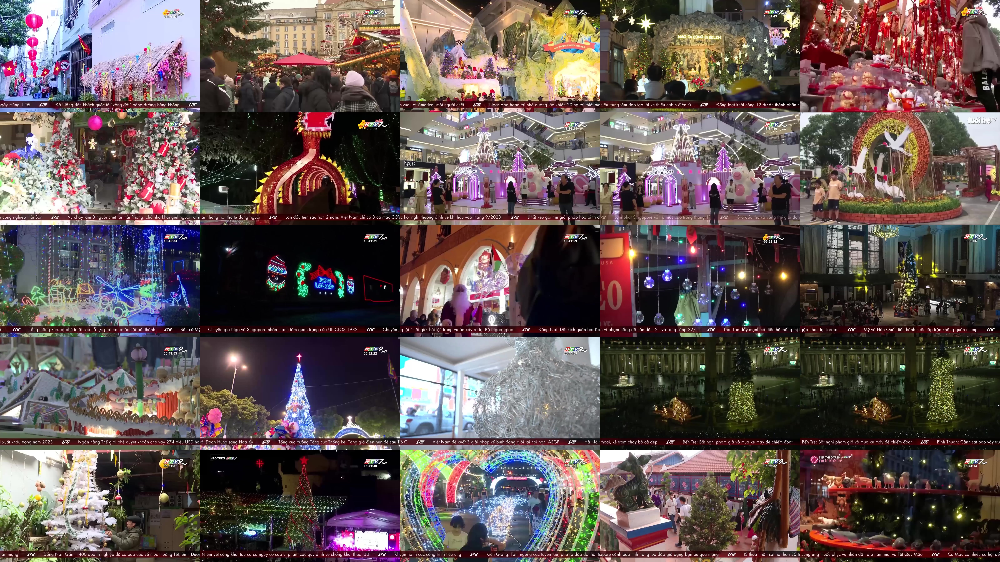

In [ ]:
#@title Base System

from IPython.display import clear_output

clear_output()

#text_query = ["one woman,yellow shirt,Dark green trash can,red lid"] #@param {type:"string"}
text_query = "A man is carrying a bag of bricks with his teeth. He wore a white shirt with the word Apollo on it." #@param {type:"string"}

#L06_V001/0010.jpg
topk = 25 #@param {type:"slider", min:0, max:50, step:1}
measure_method = 'cosin_similarity' #@param ["dot_product", "l1_norm","l2_norm","cosin_similarity","cosin_euclid"]


text_feat_arr = text_embedd(text_query)
search_result = search_engine(text_feat_arr,db, int(topk), measure_method)
images = read_image(search_result)
visualize(images)

In [17]:
#hàm map keyframe
import pandas as pd
PATH_TO_FILE_MAP='/content/drive/MyDrive/ELO@AIC/Dataset/map-keyframes/'
def map_keyframe(video_name,key_frame_id):
  df=pd.read_csv(PATH_TO_FILE_MAP+video_name+'.csv')
  return video_name+',',df.frame_idx[key_frame_id-1]

#Nộp thử nghiệm

In [ ]:
search_result

[{'video_name': 'L01_V022', 'keyframe_id': 52, 'score': 0.2988},
 {'video_name': 'L10_V005', 'keyframe_id': 71, 'score': 0.2883},
 {'video_name': 'L13_V026', 'keyframe_id': 39, 'score': 0.2837},
 {'video_name': 'L10_V005', 'keyframe_id': 72, 'score': 0.2773},
 {'video_name': 'L12_V019', 'keyframe_id': 57, 'score': 0.2769},
 {'video_name': 'L16_V023', 'keyframe_id': 28, 'score': 0.2744},
 {'video_name': 'L01_V022', 'keyframe_id': 157, 'score': 0.274},
 {'video_name': 'L20_V052', 'keyframe_id': 214, 'score': 0.274},
 {'video_name': 'L08_V010', 'keyframe_id': 267, 'score': 0.2732},
 {'video_name': 'L16_V006', 'keyframe_id': 76, 'score': 0.2725},
 {'video_name': 'L16_V018', 'keyframe_id': 8, 'score': 0.2722},
 {'video_name': 'L20_V060', 'keyframe_id': 75, 'score': 0.2712},
 {'video_name': 'L15_V031', 'keyframe_id': 60, 'score': 0.271},
 {'video_name': 'L19_V069', 'keyframe_id': 199, 'score': 0.2708},
 {'video_name': 'L03_V011', 'keyframe_id': 17, 'score': 0.2695},
 {'video_name': 'L20_V080

In [ ]:
 # In một file csv
video_names=[]
frame_idxs=[]
search_result = search_engine(text_feat_arr,db, 100, measure_method)

In [ ]:
search_result[0] = {'video_name': 'L07_V020', 'keyframe_id': 170, 'score': 0.3188}
search_result[1] = {'video_name': 'L07_V020', 'keyframe_id': 171, 'score': 0.3188}
search_result[2] = {'video_name': 'L07_V020', 'keyframe_id': 172, 'score': 0.3188}

In [ ]:
for result in search_result:
  video_name,frame_idx=map_keyframe(result['video_name'],result['keyframe_id'])
  video_names.append(video_name)
  frame_idxs.append(frame_idx)
dic={'vd_name':video_names,'fr_id':frame_idxs}
df=pd.DataFrame(dic)
df.to_csv('query-p2-'+str(11)+'.csv', index = None, header=False,sep=" ")